Welcome to my notebook! This is a copy/paste welcome message for all my notebooks :) 📓 This repository/notebook serves as a personal reminder for me, documenting code snippets and techniques sourced from various learning resources. The goal is to consolidate valuable information and create a basic reference guide. Please note that the codes included here are not originally mine, and credit goes to the respective authors and resources. Feel free to explore and use this collection as a shared learning space. Happy coding

#### Sources for this notebook : 
    * https://huggingface.co/docs/diffusers/using-diffusers/img2img 
    
#### Purpose :
    * Using image-to-image pipeline
    * using popular models
    * understanding parameters of img2img pipelines
    
#### Keywords :
    * Stable diffusion and XL 
    * Strength
    * guidance scale
    * ControlNet

Very similar to text-to-image... But here, we can also add an image as an initial point.

''...  The initial image is encoded to latent space and noise is added to it. Then the latent diffusion model takes a prompt and the noisy latent image, predicts the added noise, and removes the predicted noise from the initial latent image to get the new latent image.
...''

In [1]:
import torch
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForImage2Image.from_pretrained(
    "kandinsky-community/kandinsky-2-2-decoder", torch_dtype=torch.float16, use_safetensors=True
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
#pipeline.enable_xformers_memory_efficient_attention()

C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\utils\outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\utils\outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
Loading pipeline components...: 100%|██████████| 6/6 [00:10<00:00,  1.80s/it]


In [2]:
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/cat.png")

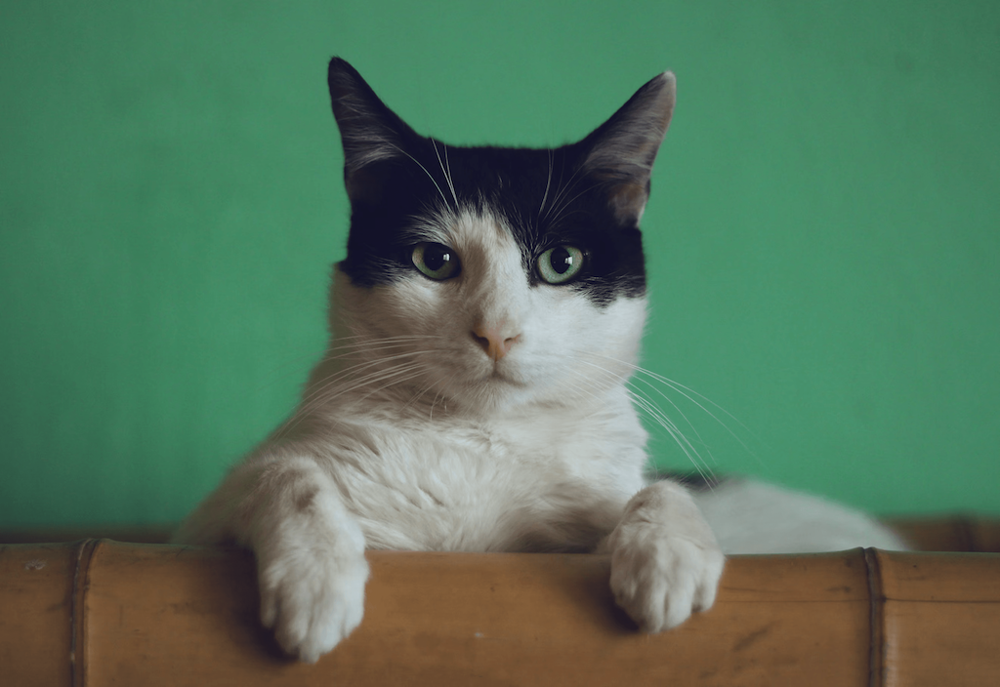

In [3]:
init_image

In [4]:
pipeline

KandinskyV22Img2ImgCombinedPipeline {
  "_class_name": "KandinskyV22Img2ImgCombinedPipeline",
  "_diffusers_version": "0.26.2",
  "_name_or_path": "kandinsky-community/kandinsky-2-2-decoder",
  "movq": [
    "diffusers",
    "VQModel"
  ],
  "prior_image_encoder": [
    "transformers",
    "CLIPVisionModelWithProjection"
  ],
  "prior_image_processor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "prior_prior": [
    "diffusers",
    "PriorTransformer"
  ],
  "prior_scheduler": [
    "diffusers",
    "UnCLIPScheduler"
  ],
  "prior_text_encoder": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "prior_tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "scheduler": [
    "diffusers",
    "DDPMScheduler"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ]
}

  0%|          | 0/25 [00:00<?, ?it/s]C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\models\attention_processor.py:1244: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:263.)
  hidden_states = F.scaled_dot_product_attention(
100%|██████████| 25/25 [00:01<00:00, 16.70it/s]
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\pipelines\kandinsky2_2\pipeline_kandinsky2_2_img2img.py:276: FutureWarning: `callback_steps` is deprecated and will be removed in version 1.0.0. Passing `callback_steps` as an input argument to `__call__` is deprecated, consider use `callback_on_step_end`
  deprecate(
100%|██████████| 30/30 [00:05<00:00,  5.19it/s]


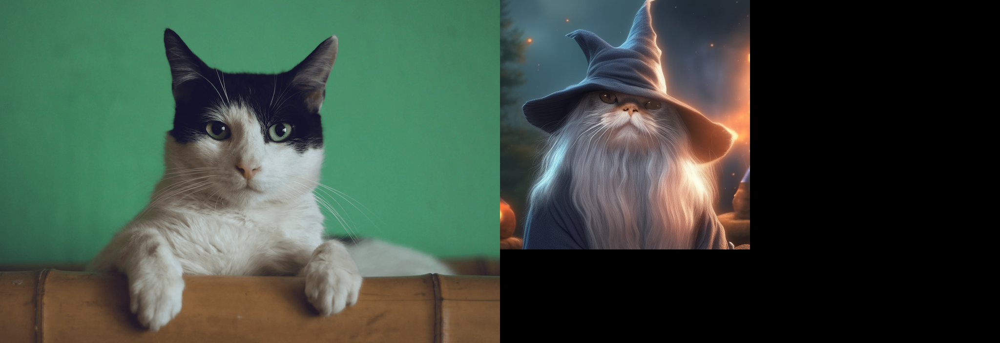

In [5]:
prompt = "cat wizard, gandalf, lord of the rings, detailed, fantasy, cute, adorable, Pixar, Disney, 8k"
image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

### POPULAR MODELS

#### Stable Diffusion 1.5v

100%|██████████| 40/40 [00:10<00:00,  3.75it/s]


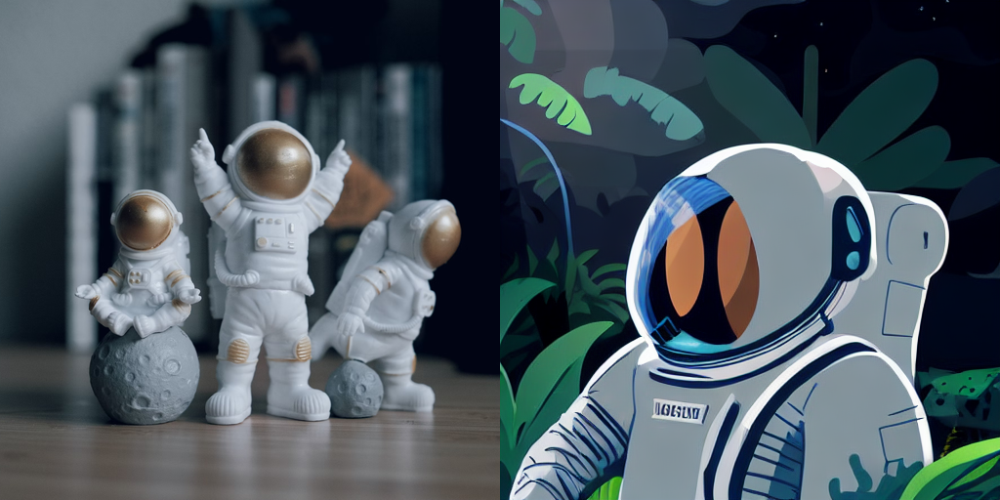

In [6]:
import torch
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import make_image_grid, load_image

pipeline = AutoPipelineForImage2Image.from_pretrained(
    "runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
#pipeline.enable_xformers_memory_efficient_attention()

# prepare image
url = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/img2img-init.png"
init_image = load_image(url)

prompt = "Astronaut in a jungle, cold color palette, muted colors, detailed, 8k"

# pass prompt and image to pipeline
image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

In [7]:
pipeline

StableDiffusionImg2ImgPipeline {
  "_class_name": "StableDiffusionImg2ImgPipeline",
  "_diffusers_version": "0.26.2",
  "_name_or_path": "runwayml/stable-diffusion-v1-5",
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "image_encoder": [
    null,
    null
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    "stable_diffusion",
    "StableDiffusionSafetyChecker"
  ],
  "scheduler": [
    "diffusers",
    "PNDMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

#### SDXL

100%|██████████| 25/25 [00:32<00:00,  1.31s/it]


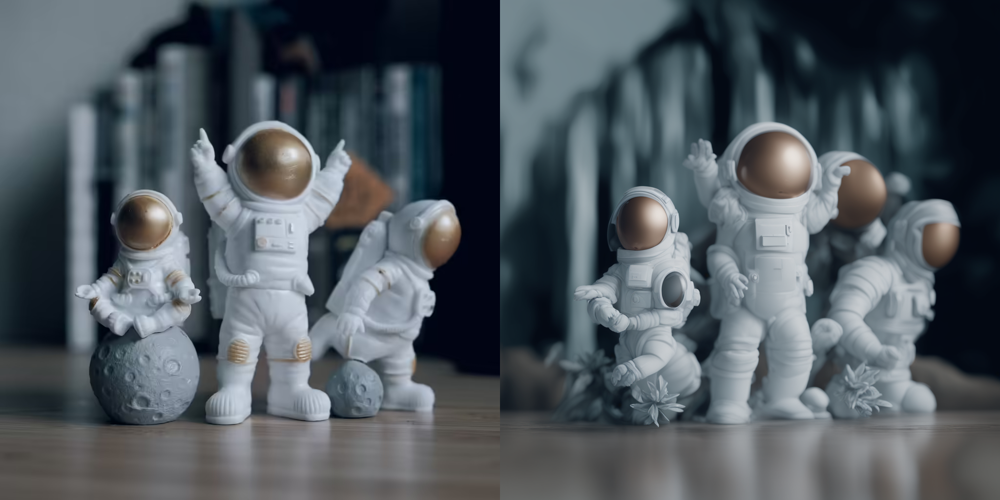

In [8]:
import torch
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import make_image_grid, load_image

pipeline = AutoPipelineForImage2Image.from_pretrained(
    "stabilityai/stable-diffusion-xl-refiner-1.0", torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
#pipeline.enable_xformers_memory_efficient_attention()

# prepare image
url = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/img2img-sdxl-init.png"
init_image = load_image(url)

prompt = "Astronaut in a jungle, cold color palette, muted colors, detailed, 8k"

# pass prompt and image to pipeline
image = pipeline(prompt, image=init_image, strength=0.5).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

#### Kandinsky 2.2

100%|██████████| 30/30 [01:19<00:00,  2.67s/it]


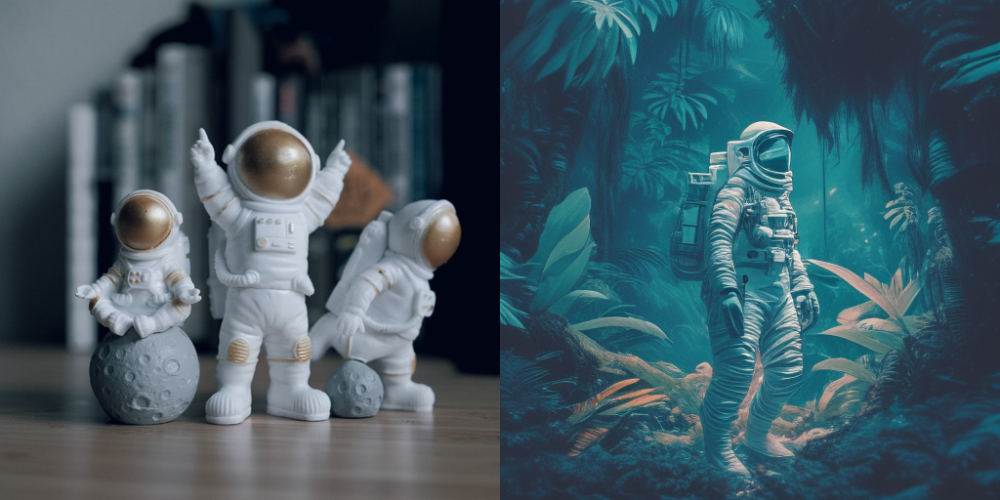

In [9]:
import torch
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import make_image_grid, load_image

pipeline = AutoPipelineForImage2Image.from_pretrained(
    "kandinsky-community/kandinsky-2-2-decoder", torch_dtype=torch.float16, use_safetensors=True
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
#pipeline.enable_xformers_memory_efficient_attention()

# prepare image
url = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/img2img-init.png"
init_image = load_image(url)

prompt = "Astronaut in a jungle, cold color palette, muted colors, detailed, 8k"

# pass prompt and image to pipeline
image = pipeline(prompt, image=init_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

### Configure pipeline parameters

#### Strength

''...strength is one of the most important parameters to consider and it’ll have a huge impact on your generated image. It determines how much the generated image resembles the initial image...''

Basically, high strength makes image more independent from initial image,lower strength value means the generated image is more similar to the initial image.

''...
The strength and num_inference_steps parameters are related because strength determines the number of noise steps to add. For example, if the num_inference_steps is 50 and strength is 0.8, then this means adding 40 (50 * 0.8) steps of noise to the initial image and then denoising for 40 steps to get the newly generated image....''


100%|██████████| 40/40 [00:10<00:00,  3.75it/s]


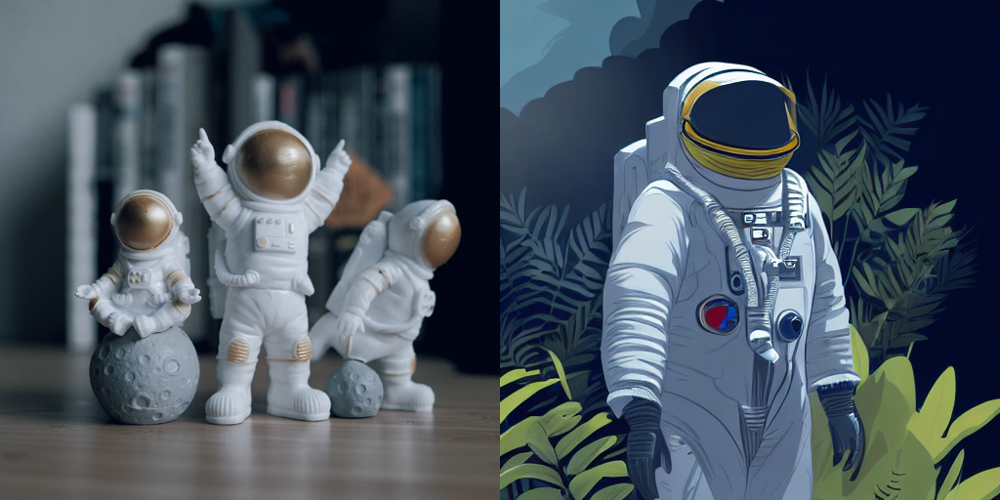

In [11]:
import torch
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import make_image_grid, load_image

pipeline = AutoPipelineForImage2Image.from_pretrained(
    "runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
#pipeline.enable_xformers_memory_efficient_attention()

# prepare image
url = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/img2img-init.png"
init_image = load_image(url)

prompt = "Astronaut in a jungle, cold color palette, muted colors, detailed, 8k"

# pass prompt and image to pipeline
image = pipeline(prompt, image=init_image, strength=0.8).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

with a small strength...

100%|██████████| 15/15 [00:03<00:00,  4.07it/s]


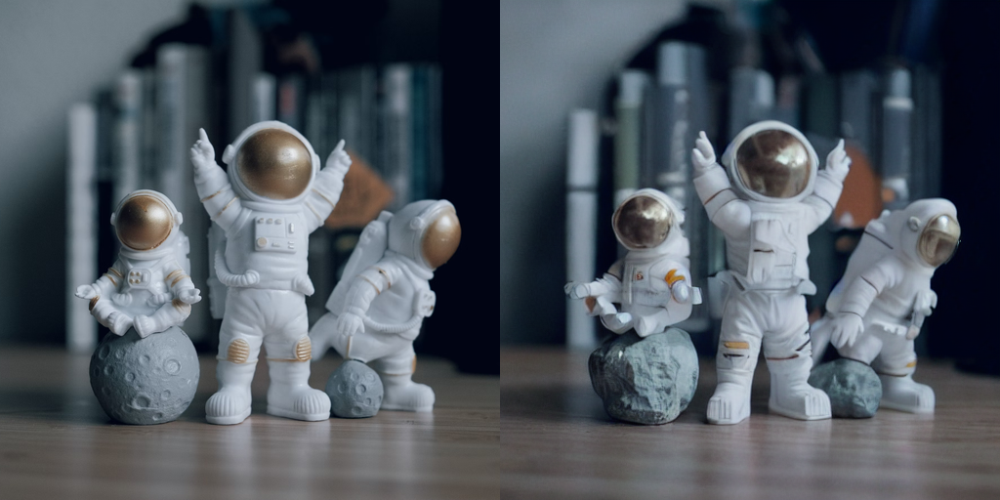

In [12]:
# pass prompt and image to pipeline
image = pipeline(prompt, image=init_image, strength=0.3).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

#### Guidance scale

The guidance_scale parameter is used to control how closely aligned the generated image and text prompt are. A higher guidance_scale value means your generated image is more aligned with the prompt.

You can combine guidance_scale with strength for even more precise control over how expressive the model is. 

100%|██████████| 40/40 [00:08<00:00,  4.80it/s]


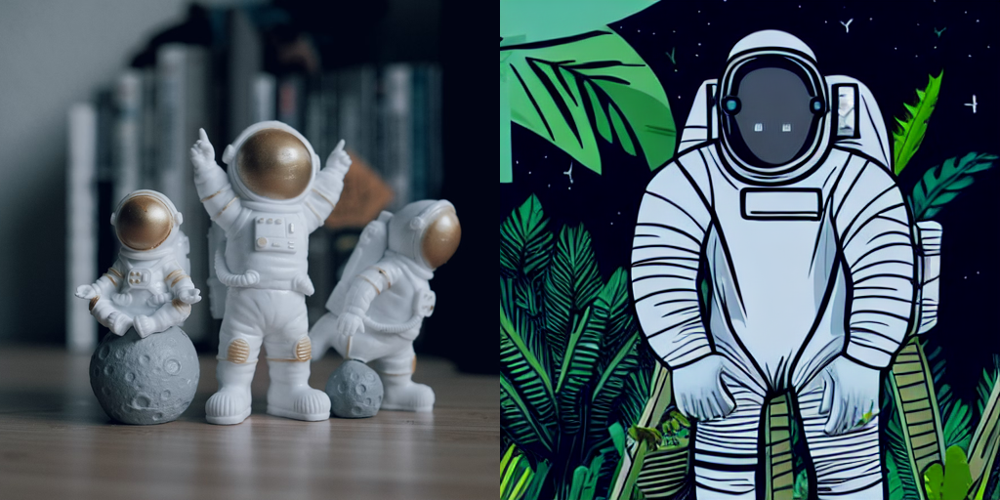

In [13]:
import torch
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import make_image_grid, load_image

pipeline = AutoPipelineForImage2Image.from_pretrained(
    "runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
#pipeline.enable_xformers_memory_efficient_attention()

# prepare image
url = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/img2img-init.png"
init_image = load_image(url)

prompt = "Astronaut in a jungle, cold color palette, muted colors, detailed, 8k"

# pass prompt and image to pipeline
image = pipeline(prompt, image=init_image, guidance_scale=8.0).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

with a small guidance.... not a clue about 'jungle'

100%|██████████| 40/40 [00:05<00:00,  7.39it/s]


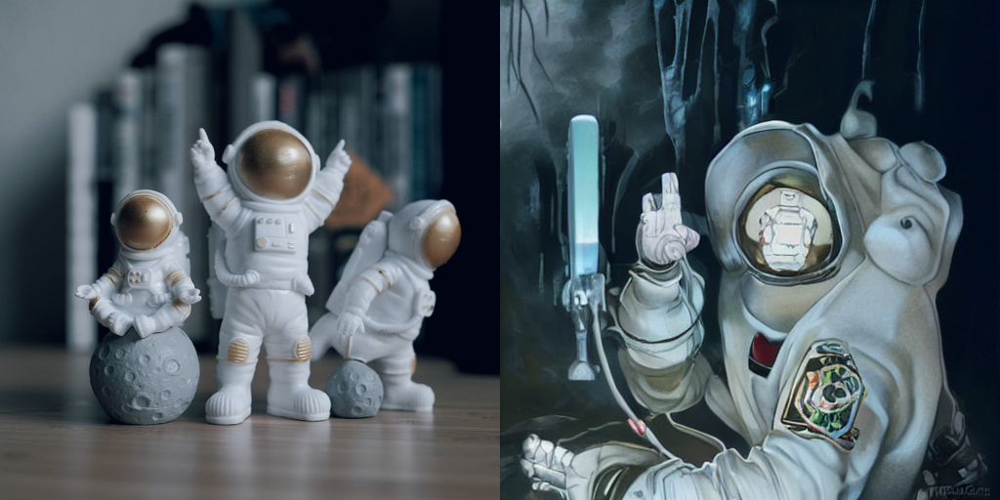

In [14]:
# pass prompt and image to pipeline
image = pipeline(prompt, image=init_image, guidance_scale=0.5).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

#### Negative prompt
A negative prompt conditions the model to not include things in an image, and it can be used to improve image quality or modify an image.

### Control image generation

#### ControlNet

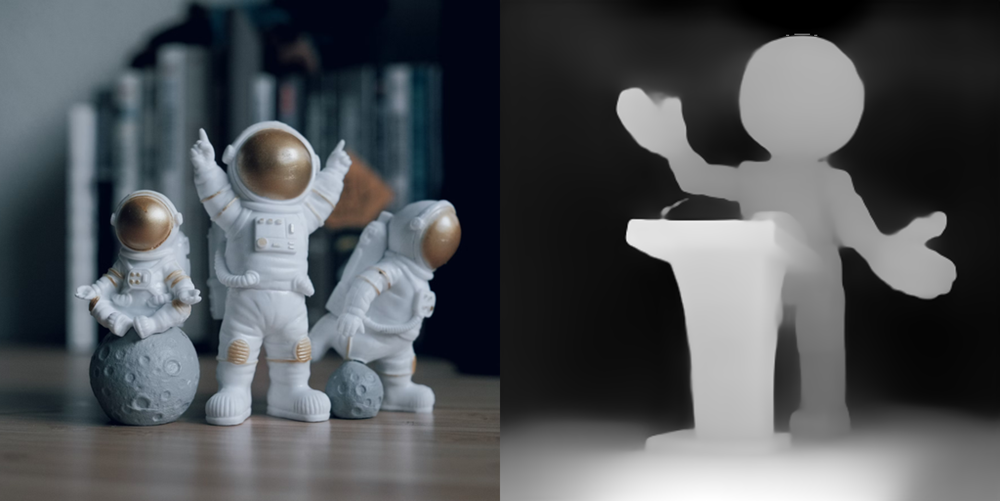

In [17]:
from diffusers.utils import load_image, make_image_grid

# prepare image
url = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/img2img-init.png"
init_image = load_image(url)
init_image = init_image.resize((958, 960)) # resize to depth image dimensions
depth_image = load_image("https://huggingface.co/lllyasviel/control_v11f1p_sd15_depth/resolve/main/images/control.png")
make_image_grid([init_image, depth_image], rows=1, cols=2)

In [22]:
from diffusers import ControlNetModel, AutoPipelineForImage2Image
import torch

controlnet = ControlNetModel.from_pretrained("lllyasviel/control_v11f1p_sd15_depth", torch_dtype=torch.float16, variant="fp16", use_safetensors=True)
pipeline = AutoPipelineForImage2Image.from_pretrained(
    "runwayml/stable-diffusion-v1-5", controlnet=controlnet, torch_dtype=torch.float16,variant="fp16", use_safetensors=True
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
#pipeline.enable_xformers_memory_efficient_attention()

Loading pipeline components...: 100%|██████████| 7/7 [00:01<00:00,  6.28it/s]


100%|██████████| 40/40 [00:48<00:00,  1.22s/it]


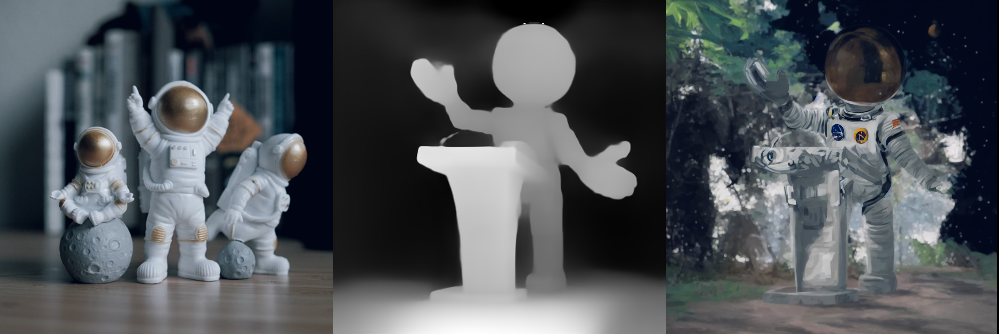

In [23]:
prompt = "Astronaut in a jungle, cold color palette, muted colors, detailed, 8k"
image_control_net = pipeline(prompt, image=init_image, control_image=depth_image).images[0]
make_image_grid([init_image, depth_image, image_control_net], rows=1, cols=3)

vae\diffusion_pytorch_model.safetensors not found
100%|██████████| 22/22 [00:18<00:00,  1.21it/s]


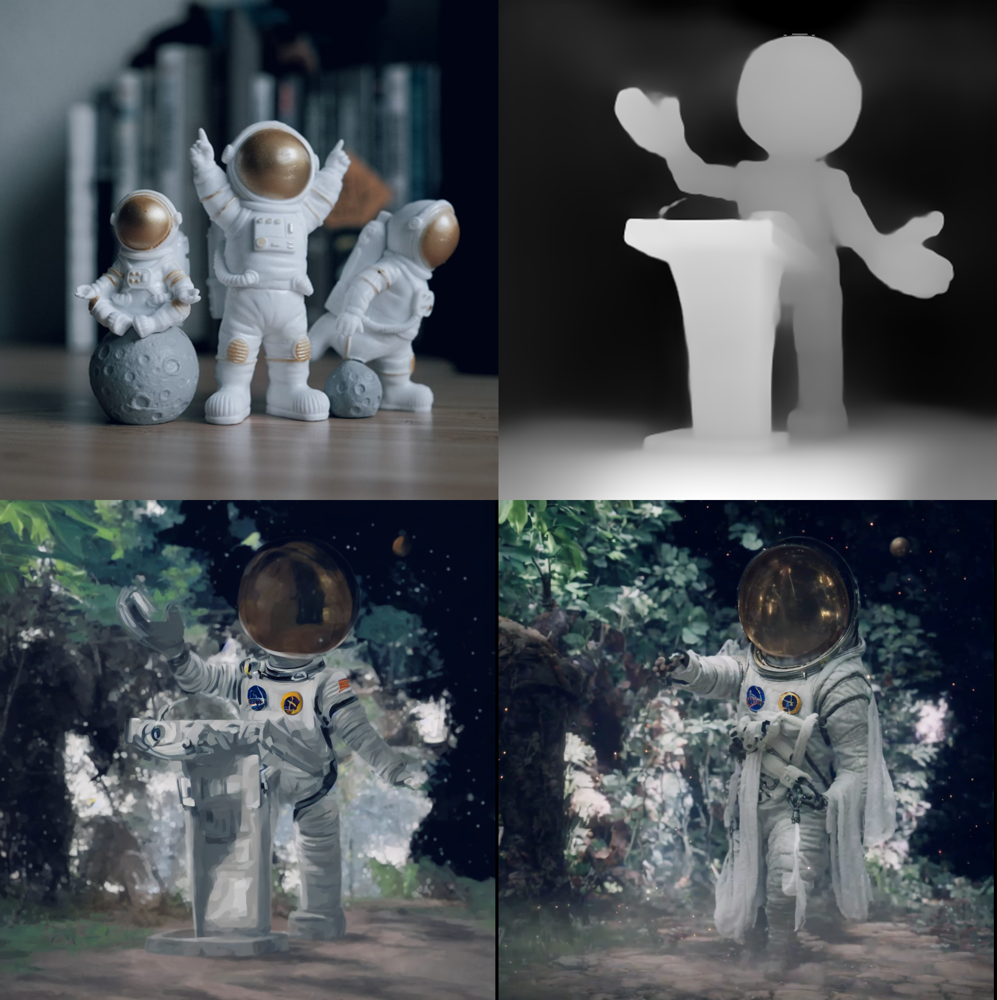

In [24]:
pipeline = AutoPipelineForImage2Image.from_pretrained(
    "nitrosocke/elden-ring-diffusion", torch_dtype=torch.float16,
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
#pipeline.enable_xformers_memory_efficient_attention()

prompt = "elden ring style astronaut in a jungle" # include the token "elden ring style" in the prompt
negative_prompt = "ugly, deformed, disfigured, poor details, bad anatomy"

image_elden_ring = pipeline(prompt, negative_prompt=negative_prompt, image=image_control_net, strength=0.45, guidance_scale=10.5).images[0]
make_image_grid([init_image, depth_image, image_control_net, image_elden_ring], rows=2, cols=2)